<a href="https://colab.research.google.com/github/guillaumew-ipssi/groupe3-projetDL/blob/main/groupe3_projetDL.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [97]:
import os
import zipfile
import math
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from google.colab import drive
from shutil import copy

Installer Google Drive en local

In [4]:
drive.mount('/content/drive')
path = '/content/drive/MyDrive'

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


Extraction ZIP sur le drive

In [ ]:
with zipfile.ZipFile(path + 'dataset-compressed.zip', 'r') as zip_ref:
    zip_ref.extractall(directory_to_extract_to)

['dataset-compressed.zip', 'Colab Notebooks']


Affichage du dataset

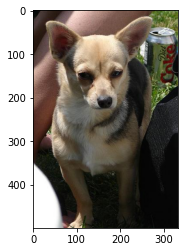

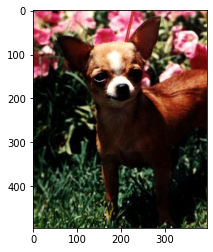

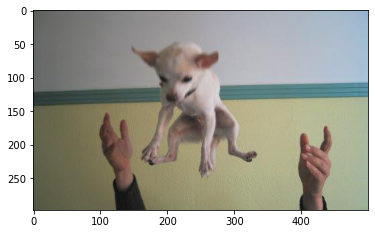

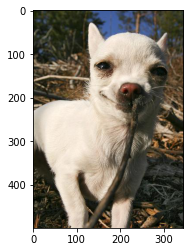

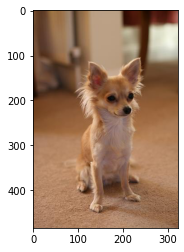

...

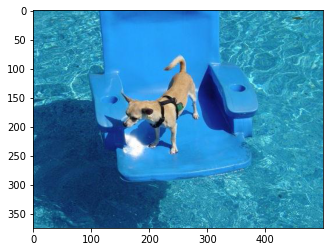

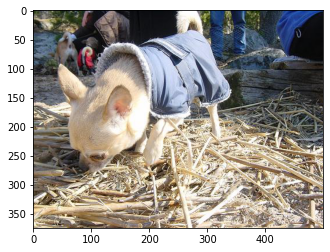

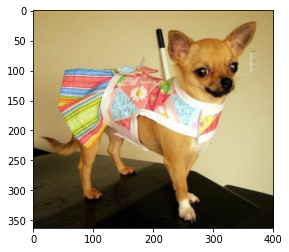

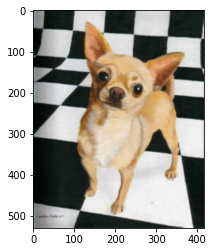

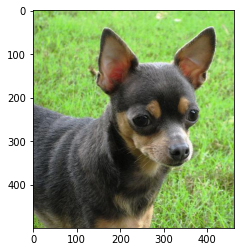

In [42]:
# Récupérer les catégories du dataset
categories = os.listdir(path + '/stanford-dogs-dataset/Images')

path_image = path + '/stanford-dogs-dataset/Images/' + categories[0] + '/'

# Afficher les résultats de la 1ère catégorie du dataset
list_images = os.listdir(path_image)

# Afficher les images de la 1ère categories
for image in list_images:
  img = mpimg.imread(path_image + image)
  imgplot = plt.imshow(img)
  plt.show()


Division du dataset (Train, Validation, Test)

In [108]:
datasets = ['train_dataset', 'validation_dataset', 'test_dataset']

#Creation des dossiers pour les datasets train, validation & tests
if not os.path.isdir(path + '/' + datasets[0]) and not os.path.isdir(path + '/' + datasets[1]) and not os.path.isdir(path + '/' + datasets[2]):
  for i in range(0, len(datasets)):
    os.mkdir(path + '/' + datasets[i])
    os.mkdir(path + '/' + datasets[i] + '/Images')

#Créer un dossier pour chaque catégorie et ajouter le % des photos à chaque catégorie
for categorie in categories:
  path_image = path + '/stanford-dogs-dataset/Images/' + categorie + '/'
  if not os.path.isdir(path + '/' + datasets[0] + '/Images/' + categorie) and not os.path.isdir(path + '/' + datasets[1] + '/Images/' + categorie) and not os.path.isdir(path + '/Images/' + datasets[2] + '/' + categorie):
    #Création des dossiers
    for i in range(0, len(datasets)):
      os.mkdir(path + '/' + datasets[i] + '/Images/' + categorie)
      
    #Copie des images
    list_images = os.listdir(path_image)
    datasets_number = getNumberElementsToDatasets(len(list_images))
    path_src = path + '/stanford-dogs-dataset/Images'
    for i in range(0, len(list_images)):
      if(i <= datasets_number['train']):
        copy(path_src + '/' + categorie + '/' + list_images[i], path + '/train_dataset/Images/' + categorie + '/')
      elif(i <= (datasets_number['train'] + datasets_number['validation']) and i > datasets_number['train']):
        copy(path_src + '/' + categorie + '/' + list_images[i], path + '/validation_dataset/Images/' + categorie + '/')
      elif( i > (datasets_number['train'] + datasets_number['validation'])):
        copy(path_src + '/' + categorie + '/' + list_images[i], path + '/test_dataset/Images/' + categorie + '/')


Vérification du split du dataset

In [115]:
#Nombre de photos présentes dans la 1ère catégorie
path_cat1 = path + '/stanford-dogs-dataset/Images/' + categories[0] + '/'

# Afficher les résultats de la 1ère catégorie du dataset d'origine
list_images = os.listdir(path_cat1)

print("Nombre de photos dans la 1ère catégorie :" + str(len(list_images)))

total = 0

for i in range(0, len(datasets)):
  # Nombre de photos présentes dans la 1ère catégorie du dataset train
  nb_images = os.listdir(path + '/' + datasets[i] + '/Images/' + categories[0] + '/')
  print("Nombre de photos dans le dataset " + datasets[i] + ": " + str(len(nb_images)))
  total += len(nb_images)

print("Le total des 3 datasets est de " + str(total))

Nombre de photos dans la 1ère catégorie :152
Nombre de photos dans le dataset train_dataset: 107
Nombre de photos dans le dataset validation_dataset: 38
Nombre de photos dans le dataset test_dataset: 7
Le total des 3 datasets est de 152


In [71]:
# Retourne le nombre correspondant aux datasets (train : 75%, validation: 25%, test: 5%)
def getNumberElementsToDatasets(length):
  train_number = math.floor(length * 70 / 100)
  validation_number = math.floor(length * 25 / 100)
  test_number = math.floor(length * 5 / 100)
  offset = length - (train_number + validation_number + test_number)
  test_number = test_number + offset

  if(length == (train_number + validation_number + test_number)):
    datasets_number = {'train' : train_number, 'validation' : validation_number, 'test' : test_number}
    return datasets_number

  return false;